In [1]:
%cd ../..

D:\Playground\AdvancedTimeSeriesForecastingBook\Github\Modern-Time-Series-Forecasting-with-Python-


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import os
import plotly.io as pio
pio.templates.default = "plotly_white"
import pandas as pd
from pathlib import Path
from tqdm.autonotebook import tqdm
import missingno as msno
import statsmodels.api as sm
%load_ext autoreload
%autoreload 2
np.random.seed()
tqdm.pandas()

D:\miniconda3\envs\modern_ts_v2\lib\site-packages\ipykernel_launcher.py:9: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  if __name__ == '__main__':


In [3]:
os.makedirs("imgs/chapter_3", exist_ok=True)
preprocessed = Path("data/london_smart_meters/proprocessed")

In [4]:
def format_plot(fig, legends = None, xlabel="Time", ylabel="Value"):
    if legends:
        names = cycle(legends)
        fig.for_each_trace(lambda t:  t.update(name = next(names)))
    fig.update_layout(
            autosize=False,
            width=900,
            height=500,
            title={
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
            titlefont={
                "size": 20
            },
            legend_title = None,
            yaxis=dict(
                title_text=ylabel,
                titlefont=dict(size=12),
            ),
            xaxis=dict(
                title_text=xlabel,
                titlefont=dict(size=12),
            )
        )
    return fig

# Reading Blocks 0-7

In [5]:
from src.utils.data_utils import compact_to_expanded

In [6]:
block_df = pd.read_parquet("data/london_smart_meters/preprocessed/london_smart_meters_merged_block_0-7.parquet")

block_df.head()

,LCLid,start_timestamp,frequency,energy_consumption,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,...,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
0,MAC000002,2012-10-13,30min,"[0.263, 0.2689999999999999, 0.275, 0.256, 0.21...",24144,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[186, 186, 188, 188, 190, 190, 203, 203, 206, ...","[8.78, 8.78, 8.27, 8.27, 7.87, 7.87, 7.89, 7.8...","[6.28, 6.28, 6.21, 6.21, 6.22, 6.22, 6.76, 6.7...","[1007.7, 1007.7, 1007.36, 1007.36, 1006.73, 10...","[7.55, 7.55, 7.34, 7.34, 6.75, 6.75, 6.89, 6.8...","[2.28, 2.28, 1.81, 1.81, 1.95, 1.95, 1.83, 1.8...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.84, 0.84, 0.87, 0.87, 0.89, 0.89, 0.93, 0.9...","[Clear, Clear, Clear, Clear, Partly Cloudy, Pa..."
1,MAC000246,2011-12-04,30min,"[0.175, 0.098, 0.144, 0.065, 0.071, 0.037, 0.0...",39216,Std,ACORN-A,Affluent,block_0,"[None, None, None, None, None, None, None, Non...",...,"[243, 243, 253, 253, 252, 252, 259, 259, 252, ...","[8.6, 8.6, 8.64, 8.64, 8.63, 8.63, 8.56, 8.56,...","[6.33, 6.33, 6.42, 6.42, 6.4, 6.4, 6.06, 6.06,...","[1003.92, 1003.92, 1003.7, 1003.7, 1003.7, 100...","[6.13, 6.13, 6.24, 6.24, 6.22, 6.22, 5.76, 5.7...","[4.31, 4.31, 4.2, 4.2, 4.2, 4.2, 5.04, 5.04, 3...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, par...","[0.86, 0.86, 0.86, 0.86, 0.86, 0.86, 0.84, 0.8...","[Mostly Cloudy, Mostly Cloudy, Mostly Cloudy, ..."
2,MAC000450,2012-03-23,30min,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8...",33936,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[78, 78, 73, 73, 81, 81, 80, 80, 75, 75, 71, 7...","[8.76, 8.76, 8.54, 8.54, 8.09, 8.09, 7.34, 7.3...","[7.25, 7.25, 7.12, 7.12, 7.17, 7.17, 6.68, 6.6...","[1027.41, 1027.41, 1026.91, 1026.91, 1026.54, ...","[7.59, 7.59, 7.43, 7.43, 7.24, 7.24, 7.34, 7.3...","[2.18, 2.18, 2.07, 2.07, 1.72, 1.72, 1.34, 1.3...","[rain, rain, rain, rain, rain, rain, rain, rai...","[fog, fog, fog, fog, fog, fog, fog, fog, fog, ...","[0.9, 0.9, 0.91, 0.91, 0.94, 0.94, 0.96, 0.96,...","[Foggy, Foggy, Foggy, Foggy, Foggy, Foggy, Fog..."
3,MAC001074,2012-05-09,30min,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21...",31680,ToU,ACORN-,ACORN-,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[215, 215, 207, 207, 215, 215, 216, 216, 126, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[10.23, 10.23, 10.17, 10.17, 10.24, 10.24, 10....","[1007.39, 1007.39, 1007.21, 1007.21, 1007.06, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[2.35, 2.35, 2.15, 2.15, 1.84, 1.84, 1.22, 1.2...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, par...","[0.92, 0.92, 0.92, 0.92, 0.93, 0.93, 0.95, 0.9...","[Partly Cloudy, Partly Cloudy, Mostly Cloudy, ..."
4,MAC003223,2012-09-18,30min,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0...",25344,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[236, 236, 240, 240, 242, 242, 244, 244, 248, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[10.82, 10.82, 10.29, 10.29, 9.86, 9.86, 9.83,...","[1011.09, 1011.09, 1010.82, 1010.82, 1010.65, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[3.86, 3.86, 3.81, 3.81, 4.27, 4.27, 4.12, 4.1...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.81, 0.81, 0.83, 0.83, 0.84, 0.84, 0.86, 0.8...","[Clear, Clear, Clear, Clear, Clear, Clear, Par..."


Let's take all the consumers in one block for our exercise. Keep in mind, you can do the same with more number of blocks as long as it fits in your RAM

In [7]:
#Converting to expanded form
exp_block_df = compact_to_expanded(block_df[block_df.file=="block_7"], timeseries_col = 'energy_consumption',
static_cols = ["frequency", "series_length", "stdorToU", "Acorn", "Acorn_grouped", "file"],
time_varying_cols = ['holidays', 'visibility', 'windBearing', 'temperature', 'dewPoint',
       'pressure', 'apparentTemperature', 'windSpeed', 'precipType', 'icon',
       'humidity', 'summary'],
ts_identifier = "LCLid")

exp_block_df.head()

  0%|          | 0/50 [00:00<?, ?it/s]

,timestamp,LCLid,energy_consumption,frequency,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,...,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
0,2011-12-09 00:00:00,MAC000050,0.137,30min,38976,Std,ACORN-D,Affluent,block_7,None,...,267,7.27,1.55,1006.59,3.31,7.39,rain,clear-night,0.67,Clear
1,2011-12-09 00:30:00,MAC000050,0.113,30min,38976,Std,ACORN-D,Affluent,block_7,None,...,267,7.27,1.55,1006.59,3.31,7.39,rain,clear-night,0.67,Clear
2,2011-12-09 01:00:00,MAC000050,0.094,30min,38976,Std,ACORN-D,Affluent,block_7,None,...,261,6.43,1.67,1007.12,2.46,6.69,rain,clear-night,0.72,Clear
3,2011-12-09 01:30:00,MAC000050,0.066,30min,38976,Std,ACORN-D,Affluent,block_7,None,...,261,6.43,1.67,1007.12,2.46,6.69,rain,clear-night,0.72,Clear
4,2011-12-09 02:00:00,MAC000050,0.092,30min,38976,Std,ACORN-D,Affluent,block_7,None,...,257,6.29,0.45,1007.85,2.18,6.96,rain,clear-night,0.66,Clear


In [8]:
# Taking a single time series from the block
ts_df = exp_block_df[exp_block_df.LCLid=="MAC000193"].set_index("timestamp")

## Fill in missing values

Let's fill in missing values because some of the decomposition techniques does not support missing values.

In [26]:
from src.imputation.interpolation import SeasonalInterpolation
ts = SeasonalInterpolation(seasonal_period=48*7).fit_transform(ts_df.energy_consumption.values.reshape(-1,1)).squeeze()

# Outlier Detection

In [239]:
import plotly.graph_objects as go

def plot_outliers(x, ts, outlier_mask, method):
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=x,
        y=ts,
        mode="lines",
        name="Original"
    ))
    fig.add_trace(go.Scatter(
        x=x[outlier_mask],
        y=ts[outlier_mask],
        mode='markers',
        marker_symbol="star",
        marker_size=5,
        name="Outliers"
    ))
    fig.update_layout(
        title_text=f"Outliers using {method}: # of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%",
        legend=dict(
            yanchor="top",
            y=0.99,
            xanchor="left",
            x=0.05
        )
    )
    return fig

In [207]:
from src.outliers.outlier_detection import detect_outlier_iqr, detect_outlier_sd, generalized_esd, seasonal_esd, detect_outlier_isolation_forest
from src.decomposition.seasonal import MultiSeasonalDecomposition, STL

## Standard Deviation

```python
def detect_outlier_sd(ts, sd_multiple=2):
    mean = ts.mean()
    std = ts.std()
    higher_bound = mean + sd_multiple*std
    lower_bound = mean - sd_multiple*std
    outlier_mask = (ts>higher_bound) | (ts<lower_bound)
    return outlier_mask
```

In [240]:
#Detecting Outliers with 3 SD window
outlier_mask = detect_outlier_sd(ts, sd_multiple=3)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 831 | % of Outliers: 2.11%


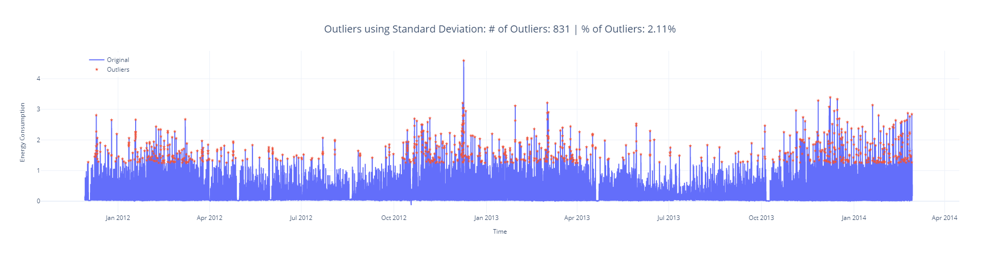

In [241]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="Standard Deviation")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_std.png")
fig.show()

In [242]:
stl = MultiSeasonalDecomposition(seasonal_model="fourier",seasonality_periods=["day_of_year", "day_of_week", "hour"], model = "additive", n_fourier_terms=10)
res = stl.fit(pd.Series(ts, index=ts_df.index))

In [243]:
#Detecting Outliers with 2 SD window
outlier_mask = detect_outlier_sd(res.resid, 3)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 756 | % of Outliers: 1.92%


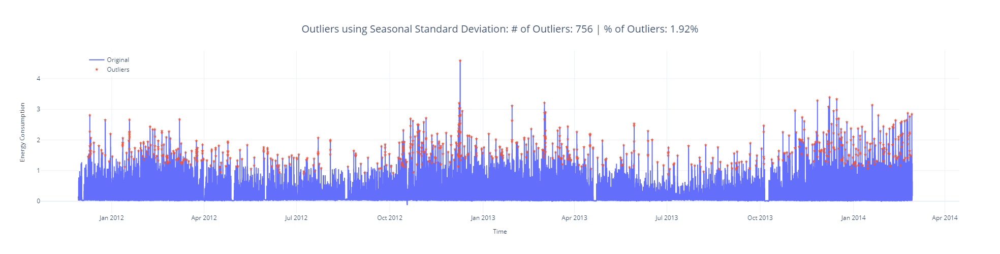

In [244]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="Seasonal Standard Deviation")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_std_seasonal.png")
fig.show()

## IQR

```python
def detect_outlier_iqr(ts, iqr_multiple=2):
    q1, q2, q3 = np.quantile(ts, 0.25), np.quantile(ts, 0.5), np.quantile(ts, 0.75)
    iqr = q3-q1
    higher_bound = q3 + iqr_multiple*iqr
    lower_bound = q1 - iqr_multiple*iqr
    outlier_mask = (ts>higher_bound) | (ts<lower_bound)
    return outlier_mask
```

In [245]:
#Detecting Outliers with 4 IQR window
outlier_mask = detect_outlier_iqr(ts, 4)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 738 | % of Outliers: 1.87%


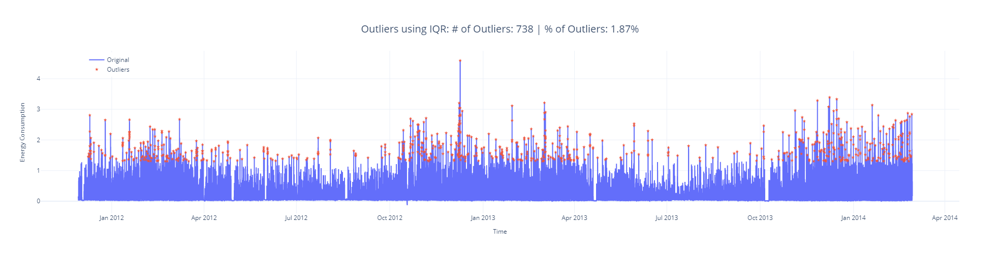

In [246]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="IQR")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_iqr.png")
fig.show()

In [247]:
#Detecting Outliers with 4 IQR window on deseasonalized data
outlier_mask = detect_outlier_iqr(res.resid, 4)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 503 | % of Outliers: 1.27%


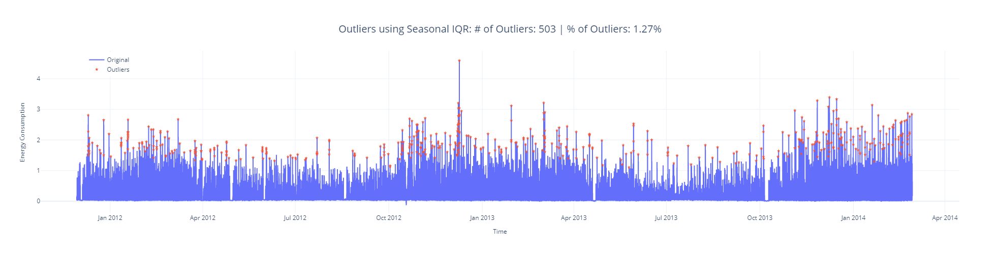

In [248]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="Seasonal IQR")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_iqr_seasonal.png")
fig.show()

## Isolation Forest

```python
class sklearn.ensemble.IsolationForest(*, n_estimators=100, max_samples='auto', contamination='auto', max_features=1.0, bootstrap=False, n_jobs=None, random_state=None, verbose=0, warm_start=False)
```

In [249]:
outlier_mask = detect_outlier_isolation_forest(ts, outlier_fraction=0.01)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 387 | % of Outliers: 0.98%


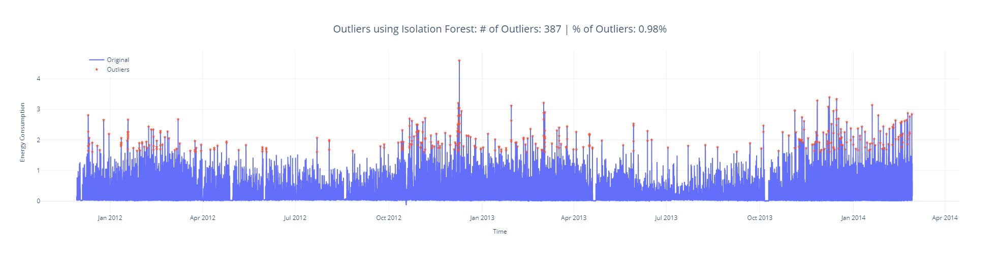

In [250]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="Isolation Forest")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_isolation_forest.png")
fig.show()

In [257]:
outlier_mask = detect_outlier_isolation_forest(res.resid.values, outlier_fraction=0.01)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 388 | % of Outliers: 0.98%


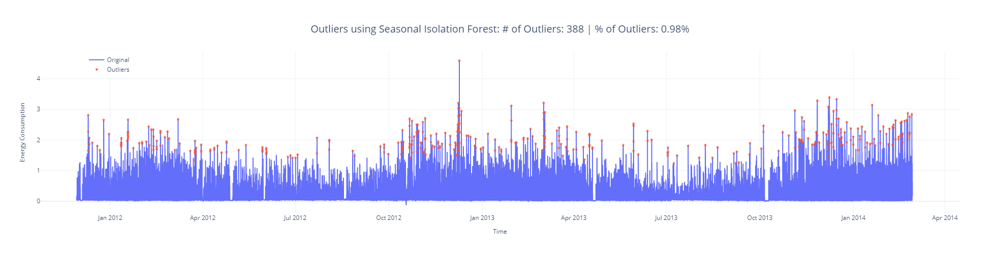

In [258]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="Seasonal Isolation Forest")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_isolation_forest_seasonal.png")
fig.show()

## Extreme Studentized Deviate (S-ESD)

In [253]:
outlier_mask = generalized_esd(ts, max_anomalies=800, alpha=0.05, hybrid=False)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 434 | % of Outliers: 1.10%


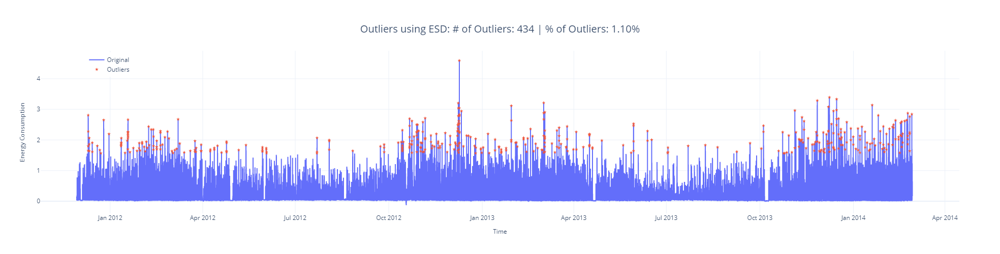

In [254]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="ESD")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_esd.png")
fig.show()

In [255]:
stl = MultiSeasonalDecomposition(seasonal_model="fourier",seasonality_periods=["day_of_year", "day_of_week", "hour"], model = "additive", n_fourier_terms=10)
outlier_mask = seasonal_esd(pd.Series(ts, index=ts_df.index), stl, max_anomalies=800, alpha=0.05, hybrid=False)
print(f"# of Outliers: {outlier_mask.sum()} | % of Outliers: {outlier_mask.sum()/len(ts)*100:.2f}%")

# of Outliers: 437 | % of Outliers: 1.11%


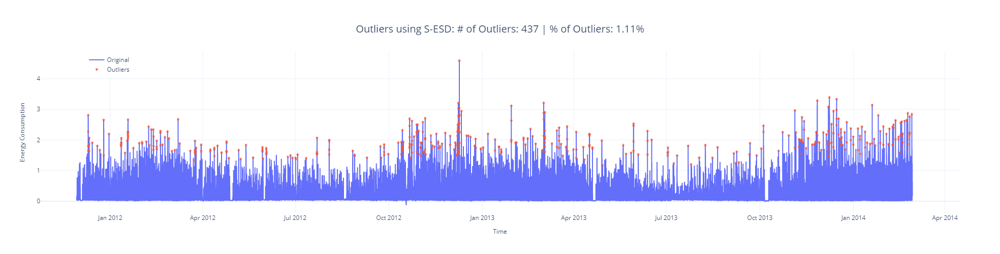

In [256]:
fig = plot_outliers(ts_df.index, ts, outlier_mask, method="S-ESD")
format_plot(fig, xlabel="Time", ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/outliers_s-esd.png")
fig.show()